# Imports and Config

In [1]:
!pip install textblob
!pip install tqdm
!pip install folium

In [2]:
%matplotlib inline

import pandas as pd
import numpy as np
from pathlib import Path
from pprint import pprint
from matplotlib import pyplot as plt
import folium
from folium import plugins
import seaborn as sns
from datetime import datetime
from  tqdm import tqdm
tqdm.pandas(desc="Progress BAR!")

In [3]:
DATA_PATH = Path("../data")
all_csvs = list(DATA_PATH.glob("*.csv"))
pprint(all_csvs)

[PosixPath('../data/hashtag_joebiden.csv'),
 PosixPath('../data/hashtag_donaldtrump.csv')]


In [4]:
## Only pick these columns
USE_COLS = [
    'created_at', 'tweet', 'likes', 'retweet_count',
    'source','user_name', 'user_screen_name','user_followers_count', 'lat',
    'long', 'country', 'state'
]

## Number of rows to include from each CSV
N_ROWS = 800000

# Loading the data

In [5]:
trump = pd.read_csv(all_csvs[0],nrows=N_ROWS,usecols=USE_COLS,lineterminator="\n")
biden = pd.read_csv(all_csvs[1],nrows=N_ROWS,usecols=USE_COLS,lineterminator="\n")
# df = pd.concat([trump,biden])

In [6]:
trump.insert(trump.shape[1],"candidate","trump")
biden.insert(biden.shape[1],"candidate","biden")
df = pd.concat([trump,biden])


In [7]:
df.shape

(1576886, 13)

In [8]:
df.head()

,created_at,tweet,likes,retweet_count,source,user_name,user_screen_name,user_followers_count,lat,long,country,state,candidate
0,2020-10-15 00:00:01,#Elecciones2020 | En #Florida: #JoeBiden dice ...,0.0,0.0,TweetDeck,El Sol Latino News,elsollatinonews,1860.0,25.774270,-80.193660,United States of America,Florida,trump
1,2020-10-15 00:00:18,#HunterBiden #HunterBidenEmails #JoeBiden #Joe...,0.0,0.0,Twitter for iPad,Cheri A. 🇺🇸,Biloximeemaw,6628.0,NaN,NaN,NaN,NaN,trump
2,2020-10-15 00:00:20,@IslandGirlPRV @BradBeauregardJ @MeidasTouch T...,0.0,0.0,Twitter Web App,Flag Waver,Flag_Wavers,1536.0,46.304036,-109.171431,United States of America,Montana,trump
3,2020-10-15 00:00:21,@chrislongview Watching and setting dvr. Let’s...,0.0,0.0,Twitter for iPhone,Michelle Ferg,MichelleFerg4,27.0,NaN,NaN,NaN,NaN,trump
4,2020-10-15 00:00:22,#censorship #HunterBiden #Biden #BidenEmails #...,1.0,0.0,Twitter Web App,the Gold State,theegoldstate,390.0,36.701463,-118.755997,United States of America,California,trump


In [9]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 1576886 entries, 0 to 799999
Data columns (total 13 columns):
 #   Column                Non-Null Count    Dtype  
---  ------                --------------    -----  
 0   created_at            1576886 non-null  object 
 1   tweet                 1576886 non-null  object 
 2   likes                 1576886 non-null  float64
 3   retweet_count         1576886 non-null  float64
 4   source                1575378 non-null  object 
 5   user_name             1576853 non-null  object 
 6   user_screen_name      1576886 non-null  object 
 7   user_followers_count  1576886 non-null  float64
 8   lat                   729962 non-null   float64
 9   long                  729962 non-null   float64
 10  country               725989 non-null   object 
 11  state                 531066 non-null   object 
 12  candidate             1576886 non-null  object 
dtypes: float64(5), object(8)
memory usage: 168.4+ MB


In [10]:
df.isna().sum()

created_at                    0
tweet                         0
likes                         0
retweet_count                 0
source                     1508
user_name                    33
user_screen_name              0
user_followers_count          0
lat                      846924
long                     846924
country                  850897
state                   1045820
candidate                     0
dtype: int64

In [11]:
df.dropna(inplace=True)
df.isna().sum()

created_at              0
tweet                   0
likes                   0
retweet_count           0
source                  0
user_name               0
user_screen_name        0
user_followers_count    0
lat                     0
long                    0
country                 0
state                   0
candidate               0
dtype: int64

In [12]:
df.shape

(530857, 13)

# Performing EDA

## Analysis Inference: Time-wise

- The total tweets had two spikes: one on Oct 23 and one on Nov 4
- The Nov 4 spike can be due to the election day
- The Oct 23 spike is peculiar as no note-worthy event happened.
- Candidate-wise Trump related tweets were always more.
- Except on the Oct 23 spike when Biden related tweets seemed to be equal to Trump's.

In [13]:
df["created_day"] = df["created_at"].apply(lambda date_str: datetime.strptime(date_str,"%Y-%m-%d %H:%M:%S").date())

In [14]:

day_wise_tweets = pd.DataFrame({
        "Total" : df.created_day.value_counts(),
        "Trump" : df[df.candidate=="trump"].created_day.value_counts(),
        "Biden" : df[df.candidate=="biden"].created_day.value_counts()
    } 
)



day_wise_tweets.rename(columns={0:"total tweets", 1:"Trump", 2: "Biden"},inplace=True)
day_wise_tweets.reset_index(inplace=True)
day_wise_tweets.head()

,index,Total,Trump,Biden
0,2020-10-15,13084,5728,7356.0
1,2020-10-16,17526,7487,10039.0
2,2020-10-17,11087,4506,6581.0
3,2020-10-18,10949,4168,6781.0
4,2020-10-19,12094,4302,7792.0


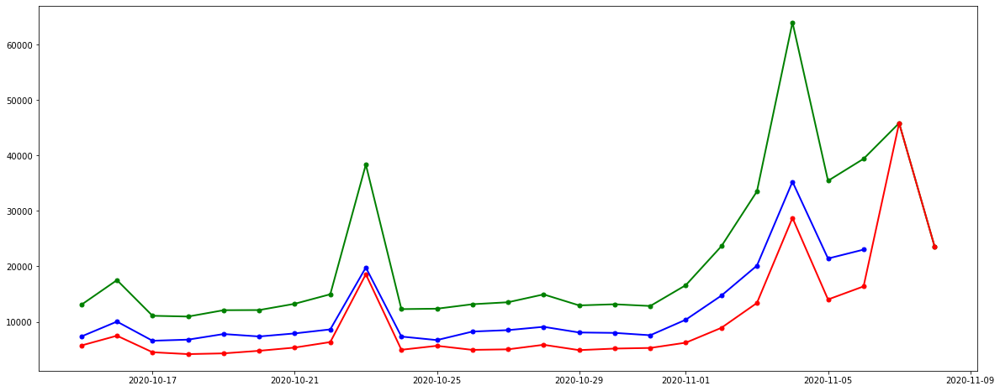

In [15]:
plt.figure(figsize=(20,8))
plt.plot(day_wise_tweets["index"], day_wise_tweets["Total"], 'go-', linewidth=2, markersize=5)
plt.plot(day_wise_tweets["index"], day_wise_tweets["Trump"], 'ro-', linewidth=2, markersize=5)
plt.plot(day_wise_tweets["index"], day_wise_tweets["Biden"], 'bo-', linewidth=2, markersize=5)



## Analysis Inference: Popularity

- There are more tweets related to Trump than Biden.
- The USA has the most amount of interactions(even on a logarithmic scale).
- It seems that on an overall scale, Joe Biden related tweets had more likes and retweets.
- Joe Biden was the most popular in India(barring USA).
- Donald Trump was the most popular in Germany(barring USA).
- It seems that India, the UK, France and Germany are the countries where both candidates' tweets have recieved massive reactions(barring USA).  


Text(0.5, 1.0, 'Number of Tweets per candidate')

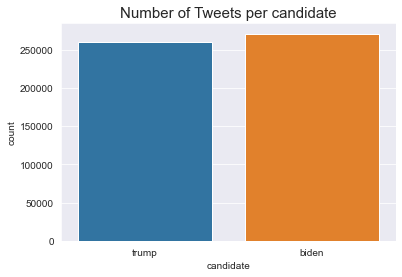

In [16]:
sns.set_style(style="darkgrid")
ax = sns.countplot(x='candidate', data=df)
ax.set_title("Number of Tweets per candidate",fontdict={"size":15})

In [17]:
x = df.groupby(["country", "candidate"]).agg("sum")
likes = x["likes"].unstack()
rts = x["retweet_count"].unstack()

In [18]:
likes.head()

candidate,biden,trump
country,,
Afghanistan,75.0,132.0
Albania,15.0,93.0
Algeria,1.0,NaN
Angola,68.0,16.0
Argentina,5183.0,4159.0


In [19]:
rts.head()

candidate,biden,trump
country,,
Afghanistan,15.0,15.0
Albania,0.0,19.0
Algeria,0.0,NaN
Angola,1.0,1.0
Argentina,1581.0,1587.0


In [20]:
## Lets look at which country are the candidates most popular in...
total_likes = likes.sum()
total_rts = rts.sum()

more_rted_candidate = "Trump" if total_rts["biden"] < total_rts["trump"] else "Biden"
more_liked_candidate = "Trump" if total_likes["biden"] < total_likes["trump"] else "Biden"

print(f"{more_liked_candidate} has more likes overall!")
print(f"{more_rted_candidate} has more Retweetes overall!")


Trump has more likes overall!
Trump has more Retweetes overall!


In [21]:
## Lets see which candidate is more popular per country
trump_top_10 = likes.trump.sort_values(ascending=False)[1:11]
biden_top_10 = likes.biden.sort_values(ascending=False)[1:11]


<AxesSubplot:xlabel='country'>

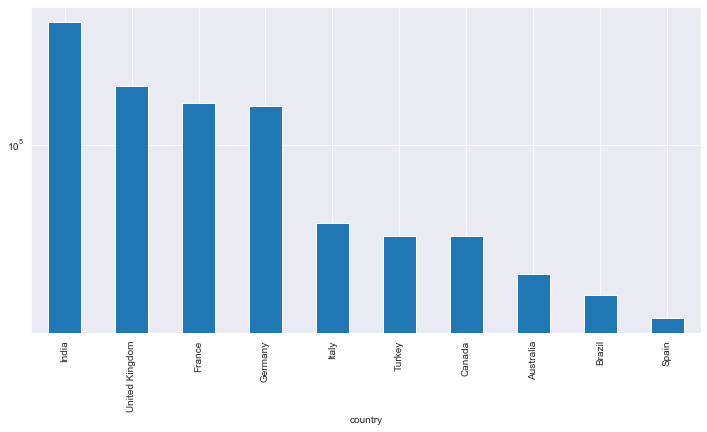

In [22]:
trump_top_10.plot(kind="bar",logy=True,figsize=(12,6))

<AxesSubplot:xlabel='country'>

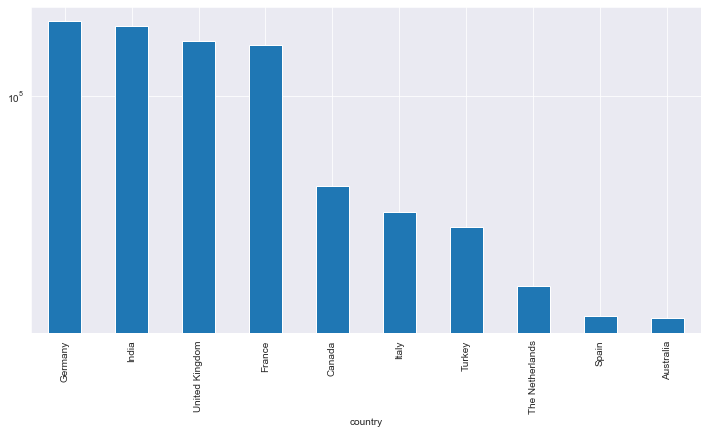

In [23]:
biden_top_10.plot(kind="bar",logy=True,figsize=(12,6))

## Analysis Inference: Tweet Sources

- The USA did significantly higher number of tweets than the other countries.
- As observed in popularity, the countries of UK, India, France and Germany are seen to be tweeting the most.
- Most of the users tweeted from the generic web app or through their phones.
- In phones, iPhone users seem to tweet more compared to android.


Text(0, 0.5, 'TWEETS (LOG SCALE)')

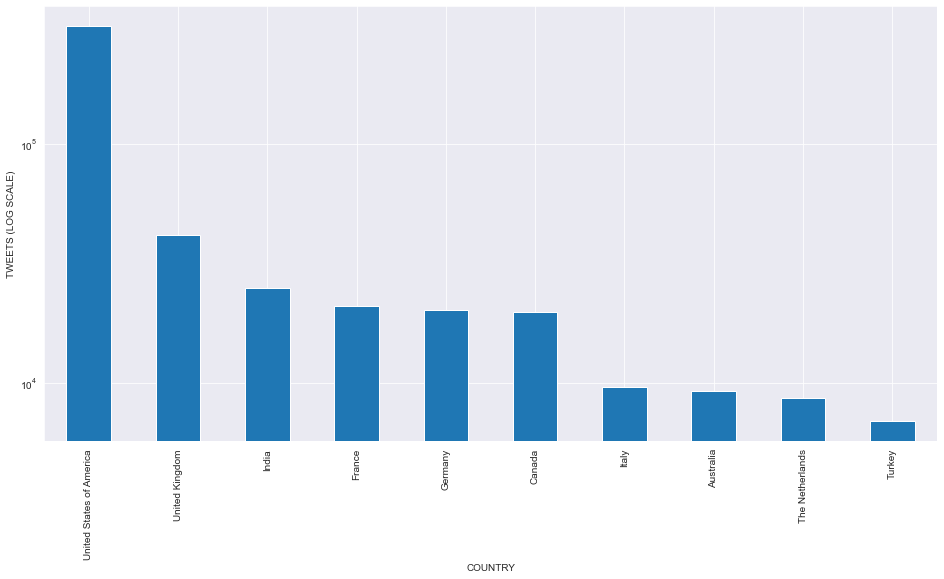

In [24]:
# Top ten countries that tweeted
ax = df.country.value_counts()[:10].plot(kind="bar",figsize=(16,8),logy=True)
ax.set_xlabel("COUNTRY")
ax.set_ylabel("TWEETS (LOG SCALE)")


<AxesSubplot:ylabel='source'>

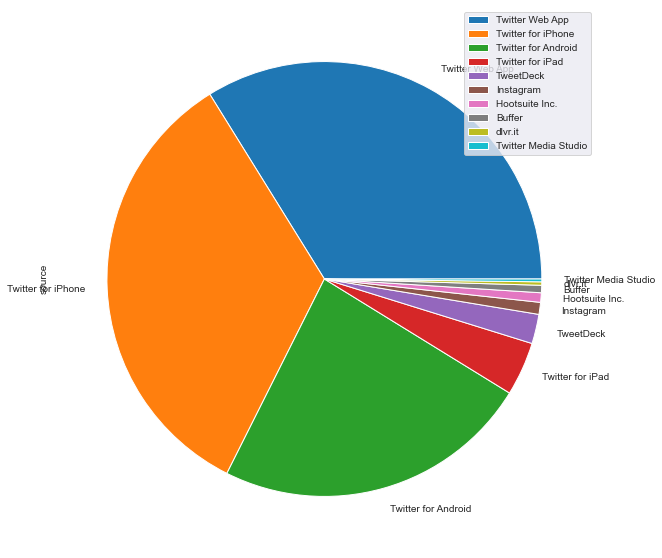

In [25]:
# Top 10 sources of tweets
df.source.value_counts()[:10].plot(kind="pie",figsize=(10, 10),legend=True)

# Visualizing the Geospatial Distribution of Tweets

In this section, we visualize where the tweets come from on an interactive map!

In [26]:
#USING FAST MARKER CLUSTER FOR LARGE DATASET
from folium.plugins import FastMarkerCluster

m = folium.Map([37.0902, -95.7129], zoom_start=4)
data = df[['lat', 'long']].to_numpy()

popups = df["tweet"].tolist()
# plot heatmap
# m.add_children(plugins.HeatMap(data, radius=10,scale_radius=True,blur=10))
plugins.FastMarkerCluster(data, popups=popups).add_to(m)
m

In [27]:
m = folium.Map([37.0902, -95.7129], zoom_start=4)
data = df[['lat', 'long']].to_numpy()
# plot heatmap
data.shape
m.add_child(plugins.HeatMap(data, radius=10,scale_radius=True,blur=10))
m

<ipython-input-27-d61cbf2a4b79>:5: FutureWarning: Method `add_children` is deprecated. Please use `add_child` instead.
  m.add_children(plugins.HeatMap(data, radius=10,scale_radius=True,blur=10))


# ------------------ SENTIMENT ANALYSIS ------------------

## IMPORTS FOR SENTIMENT ANALYSIS

In [28]:
import io
import plotly.graph_objects as go
import plotly.offline as pyo
from textblob import TextBlob
from nltk.util import ngrams
from nltk.classify import NaiveBayesClassifier
from nltk.corpus import subjectivity
from nltk.sentiment import SentimentAnalyzer
from nltk.sentiment.util import *
from nltk.sentiment.vader import SentimentIntensityAnalyzer
from nltk.tokenize import word_tokenize
from nltk.corpus import stopwords
pyo.init_notebook_mode()
nltk.download('punkt')
nltk.download('stopwords')
nltk.download('wordnet')

[nltk_data] Downloading package punkt to /home/ice9/nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package stopwords to /home/ice9/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!
[nltk_data] Downloading package wordnet to /home/ice9/nltk_data...
[nltk_data]   Package wordnet is already up-to-date!


True

## Defining a method for Cleaning Data

In [29]:
stop_words = set(stopwords.words('english'))
def clean(text):
    '''Make text lowercase, remove text in square brackets,remove links,remove punctuation
    and remove words containing numbers.'''
    text = str(text).lower()
    text = re.sub('\[.*?\]', '', text)
    text = re.sub('https?://\S+|www\.\S+', '', text)
    text = re.sub('<.*?>+', '', text)
    text = re.sub('\n', '', text)
    text = re.sub('\w*\d\w*', '', text)
    text=re.sub(r'@[A-Za-z0-9]+','',text)
    text=re.sub(r'#','',text)
    text=re.sub(r'RT[\s]+','',text)
    text=re.sub(r'[^\w]', ' ', text)
    filtered_tweet=[]
    words = word_tokenize(text) 
    for word in words:
        if word not in stop_words:
            filtered_tweet.append(word)
    return " ".join(filtered_tweet)

In [30]:
import re
import nltk
import unicodedata
from typing import Iterable, Dict, Any, List

In [31]:
def lemmatize(text):
    filtered_sent=""
    wnl = nltk.stem.WordNetLemmatizer()
    stopwords = nltk.corpus.stopwords.words('english')
    text = (unicodedata.normalize('NFKD', text)
            .encode('ascii', 'ignore')
            .decode('utf-8', 'ignore')
            .lower())
    text = re.sub(r'https?.+|[^(a-zA-Z)(0-9)\s]',' ',text)
    words = text.split()
    return " ".join([wnl.lemmatize(word) for word in words if word not in stopwords])

## Defining methods for Sentiment Analysis via Textblob

In [32]:
# create fuction to get the subjectivity and polarity
def getSubjectivity(text):
    return TextBlob(text).sentiment.subjectivity
    
def getPolarity(text):
    return TextBlob(text).sentiment.polarity

def getAnalysis(score):
    if score < 0:
        return 'negative'
    elif score==0:
        return 'neutral'
    else:
        return 'positive'

# Defining a Method for Making Wordclouds

In [33]:
#Define Wordcloud method
from wordcloud import WordCloud, STOPWORDS, ImageColorGenerator

def word_cloud(wd_list):
    stopwords = set(STOPWORDS)
    all_words = ' '.join([text for text in wd_list])
    wordcloud = WordCloud(
        background_color='white',
        stopwords=stopwords,
        width=1600,
        height=800,
        random_state=1,
        colormap='jet',
        max_words=80,
        max_font_size=200).generate(all_words)
    plt.figure(figsize=(12, 10))
    plt.axis('off')
    plt.imshow(wordcloud, interpolation="bilinear");


In [34]:
df.columns

Index(['created_at', 'tweet', 'likes', 'retweet_count', 'source', 'user_name',
       'user_screen_name', 'user_followers_count', 'lat', 'long', 'country',
       'state', 'candidate', 'created_day'],
      dtype='object')

## SENTIMENT ANALYSIS ON TRUMP RELATED TWEETS

### CLEANING DATA AND USING TEXTBLOB TO GET POLARITY AND SUBJECTIVITY

In [35]:
trump_tweets = df.query('(candidate == "trump")').sort_values('user_followers_count',ascending = False)#.drop_duplicates(['user_name'])[['tweet','country']]
trump_tweets = trump_tweets.dropna().loc[trump_tweets.country == 'United States of America']

trump_tweets.reset_index(inplace = True, drop = True)

trump_tweets['ClearTweet'] = trump_tweets['tweet'].progress_apply(clean)
trump_tweets['ClearTweet'] = trump_tweets['ClearTweet'].progress_apply(lemmatize)
trump_tweets['subjectivity']= trump_tweets['ClearTweet'].progress_apply(getSubjectivity)
trump_tweets['polarity']    = trump_tweets['ClearTweet'].progress_apply(getPolarity)
trump_tweets['analysis']    = trump_tweets['polarity'].progress_apply(getAnalysis)
trump_tweets.head()



Progress BAR!: 100%|██████████| 153577/153577 [00:00<00:00, 1039135.43it/s]


,created_at,tweet,likes,retweet_count,source,user_name,user_screen_name,user_followers_count,lat,long,country,state,candidate,created_day,ClearTweet,subjectivity,polarity,analysis
0,2020-10-25 17:13:14,#JoeBiden is enlisting A-list star power to he...,73.0,4.0,Twitter Web App,Perez Hilton,PerezHilton,5750841.0,34.053691,-118.242766,United States of America,California,trump,2020-10-25,joebiden enlisting list star power help close ...,0.0000,0.00000,neutral
1,2020-11-07 18:53:10,Celebs are just as excited as we are that Amer...,226.0,14.0,Hootsuite Inc.,Perez Hilton,PerezHilton,5747840.0,34.053691,-118.242766,United States of America,California,trump,2020-11-07,celebs excited america voted blue congrats pre...,0.6625,0.49375,positive
2,2020-11-08 20:19:52,While we were campaigning across battleground ...,717.0,55.0,Twitter Media Studio,COMMON,common,5477365.0,41.875562,-87.624421,United States of America,Illinois,trump,2020-11-08,campaigning across battleground state ran grea...,0.7500,0.80000,positive
3,2020-11-03 19:55:57,The big fight TODAY!!!!! @realDonaldTrump vs #...,22641.0,2543.0,Twitter for iPhone,danawhite,danawhite,5476752.0,36.167256,-115.148516,United States of America,Nevada,trump,2020-11-03,big fight today v joebiden got merica,0.1000,0.00000,neutral
4,2020-11-08 02:07:06,"During his victory speech, #JoeBiden said he u...",406.0,40.0,Twitter for Advertisers (legacy),The Hollywood Reporter,THR,3264793.0,34.098003,-118.329523,United States of America,California,trump,2020-11-08,victory speech joebiden said understood trump ...,0.7500,-0.75000,negative


In [36]:
trump_tweets.shape

(153577, 18)

Text(0.5, 1.0, 'Dataset labels distribuition')

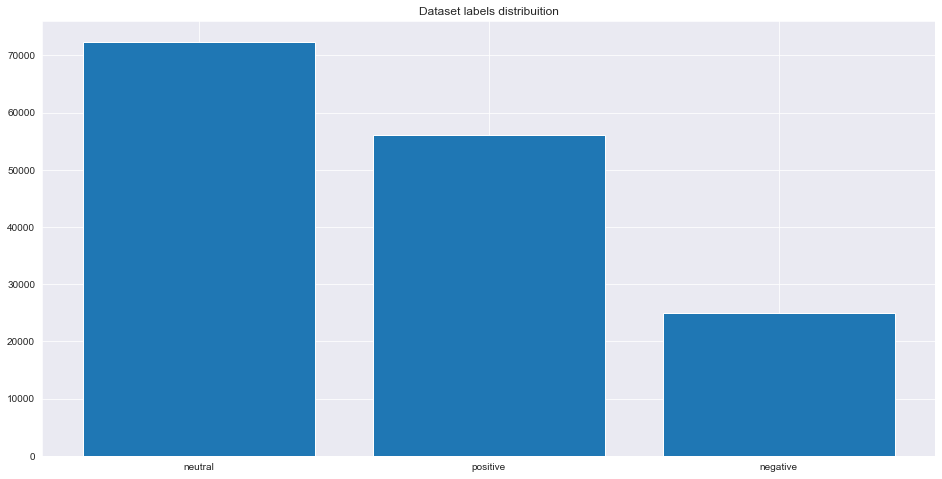

In [37]:
from collections import Counter

target_cnt = Counter(trump_tweets.analysis)

plt.figure(figsize=(16,8))
plt.bar(target_cnt.keys(), target_cnt.values())
plt.title("Dataset labels distribuition")

In [38]:
general  = trump_tweets.groupby('analysis').analysis.count()
neutral  = trump_tweets[trump_tweets['analysis'] == 'neutral'].ClearTweet.count()
positive = trump_tweets[trump_tweets['analysis'] == 'positive'].ClearTweet.count()
negative = trump_tweets[trump_tweets['analysis'] == 'negative'].ClearTweet.count()

fig = go.Figure(data = [go.Funnelarea(labels = ["positive","negative","neutral"], values = [positive,negative,neutral])])
fig.update_layout(title_text ='Sentiment analysis  Donald Trump Tweets')
fig.show()

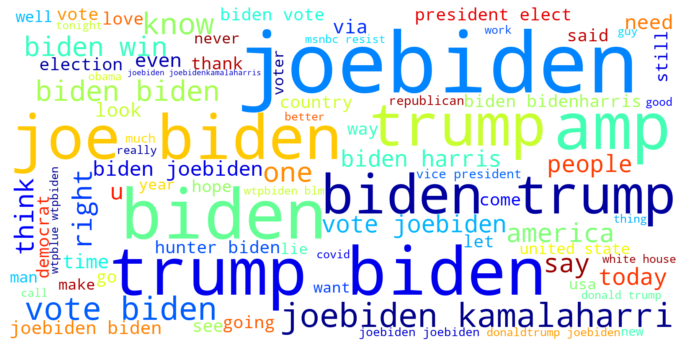

In [39]:
#Plot trump wordcloud
word_cloud(trump_tweets['ClearTweet'])

## SENTIMENT ANALYSIS ON BIDEN RELATED TWEETS

### CLEANING DATA AND USING TEXTBLOB TO GET POLARITY AND SUBJECTIVITY

In [40]:
biden_tweets = df.query('(candidate == "biden")').sort_values('user_followers_count',ascending = False)#.drop_duplicates(['user_name'])[['tweet','country']]
biden_tweets = biden_tweets.dropna().loc[biden_tweets.country == 'United States of America']

biden_tweets.reset_index(inplace = True, drop = True)

biden_tweets['ClearTweet'] = biden_tweets['tweet'].progress_apply(clean)
biden_tweets['ClearTweet'] = biden_tweets['tweet'].progress_apply(lemmatize)
biden_tweets['subjectivity']= biden_tweets['ClearTweet'].progress_apply(getSubjectivity)
biden_tweets['polarity']    = biden_tweets['ClearTweet'].progress_apply(getPolarity)
biden_tweets['analysis']    = biden_tweets['polarity'].progress_apply(getAnalysis)
biden_tweets.head()


Progress BAR!: 100%|██████████| 157080/157080 [00:00<00:00, 1073356.54it/s]


,created_at,tweet,likes,retweet_count,source,user_name,user_screen_name,user_followers_count,lat,long,country,state,candidate,created_day,ClearTweet,subjectivity,polarity,analysis
0,2020-10-20 22:52:44,"President Donald #Trump’s youngest daughter, T...",56.0,16.0,SocialNewsDesk,USA TODAY,USATODAY,4163175.0,40.463179,-88.819661,United States of America,Illinois,biden,2020-10-20,president donald trump youngest daughter tiffa...,0.000000,0.0,neutral
1,2020-10-27 03:00:18,Woah. Have you read this article?\n\nAll the p...,695.0,291.0,Twitter for iPhone,Alyssa Milano,Alyssa_Milano,3750110.0,34.053691,-118.242766,United States of America,California,biden,2020-10-27,woah read article president debt donald trump ...,0.000000,0.0,neutral
2,2020-11-06 10:30:06,Actress #NatalieMorales explained why some Lat...,99.0,21.0,SocialFlow,The Hollywood Reporter,THR,3264524.0,34.098003,-118.329523,United States of America,California,biden,2020-11-06,actress nataliemorales explained latinx voter ...,0.000000,0.0,neutral
3,2020-11-05 15:35:11,#JimmyKimmel offered his view about how the la...,73.0,1.0,SocialFlow,The Hollywood Reporter,THR,3264260.0,34.098003,-118.329523,United States of America,California,biden,2020-11-05,jimmykimmel offered view last day gone close r...,0.066667,0.0,neutral
4,2020-11-05 16:16:20,#SethMeyers lambastes Fox News for parroting #...,73.0,4.0,SocialFlow,The Hollywood Reporter,THR,3264260.0,34.098003,-118.329523,United States of America,California,biden,2020-11-05,sethmeyers lambastes fox news parroting donald...,0.000000,0.0,neutral


In [41]:
biden_tweets.shape

(157080, 18)

Text(0.5, 1.0, 'Biden Polarity Distribution')

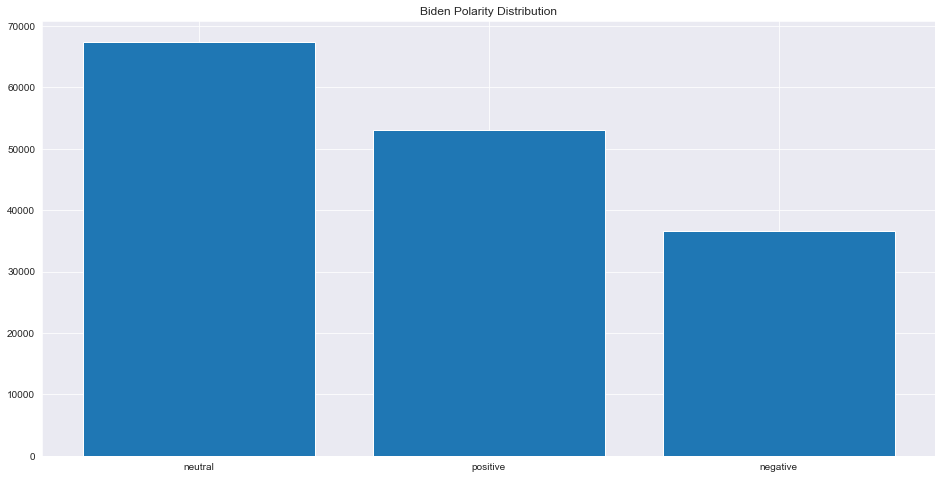

In [42]:
#Chart Polarity Distribution
from collections import Counter

target_cnt = Counter(biden_tweets.analysis)

plt.figure(figsize=(16,8))
plt.bar(target_cnt.keys(), target_cnt.values())
plt.title("Biden Polarity Distribution")

In [43]:
#Chart Sentiment Distribution
general  = biden_tweets.groupby('analysis').analysis.count()
neutral  = biden_tweets[biden_tweets['analysis'] == 'neutral'].ClearTweet.count()
positive = biden_tweets[biden_tweets['analysis'] == 'positive'].ClearTweet.count()
negative = biden_tweets[biden_tweets['analysis'] == 'negative'].ClearTweet.count()

fig = go.Figure(data = [go.Funnelarea(labels = ["positive","negative","neutral"], values = [positive,negative,neutral])])
fig.update_layout(title_text ='Sentiment analysis  Joe Biden Tweets')
fig.show()

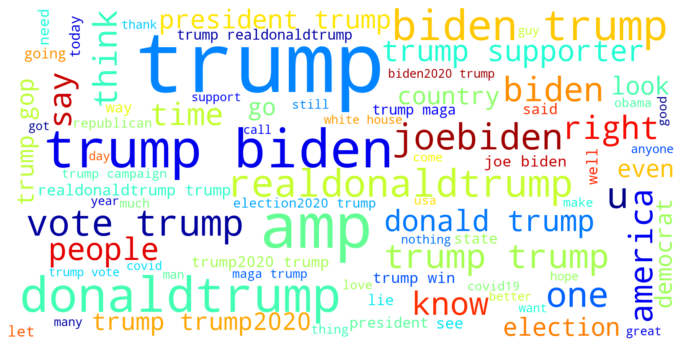

In [44]:
#Plot Biden wordcloud
word_cloud(biden_tweets['ClearTweet'])

## Based on the Final sentiment of tweet , lets see if each state is Democratic or Republic

### Defining methods for analysis and categorize states based on polarity

In [45]:
states=biden_tweets['state'].unique()

tweets_trump_location = trump_tweets.groupby(['state', 'analysis']).count()
tweets_trump_location = tweets_trump_location['user_name']
tweets_biden_location = biden_tweets.groupby(['state', 'analysis']).count()
tweets_biden_location = tweets_biden_location['user_name']
tweets_location_df = pd.DataFrame({'State': [state for state in states],
        'Trump Positive': [0 for state in states],
        'Trump Negative': [0 for state in states],
        'Trump Neutral': [0 for state in states],
        'Trump Total': [0 for state in states],
        'Biden Positive': [0 for state in states],
        'Biden Negative': [0 for state in states],
        'Biden Neutral': [0 for state in states],
        'Biden Total': [0 for state in states]})
tweets_location_df.set_index('State', inplace = True)
for state in states:
  positiveTrump, negativeTrump, neutralTrump, positiveBiden, negativeBiden, neutralBiden = 0, 0, 0, 0, 0, 0
  try:
    positiveTrump = tweets_trump_location[state]['positive']
  except:
    positiveTrump = 0
  
  try:
    negativeTrump = tweets_trump_location[state]['negative']
  except:
    negativeTrump = 0
  
  try:
    neutralTrump = tweets_trump_location[state]['neutral']
  except:
    neutralTrump = 0
  
  try:
    positiveBiden = tweets_biden_location[state]['positive']
  except:
    positiveBiden = 0
  
  try:
    negativeBiden = tweets_biden_location[state]['negative']
  except:
    negativeBiden = 0
  
  try:
    neutralBiden = tweets_biden_location[state]['neutral']
  except:
    neutralBiden = 0

  totalTrump = positiveTrump + negativeTrump + neutralTrump
  totalBiden = positiveBiden + negativeBiden + neutralBiden

  if totalTrump == 0:
    tweets_location_df.at[state, 'Trump Positive'], tweets_location_df.at[state, 'Trump Negative'], tweets_location_df.at[state, 'Trump Neutral'] = 0,0,0
  else:
    tweets_location_df.at[state, 'Trump Positive'] = positiveTrump
    tweets_location_df.at[state, 'Trump Negative'] = negativeTrump
    tweets_location_df.at[state, 'Trump Neutral'] = neutralTrump
  tweets_location_df.at[state, 'Trump Total'] = totalTrump
  
  if totalBiden == 0:
    tweets_location_df.at[state, 'Biden Positive'], tweets_location_df.at[state, 'Biden Negative'], tweets_location_df.at[state, 'Biden Neutral'] = 0,0,0
  else:
    tweets_location_df.at[state, 'Biden Positive'] = positiveBiden
    tweets_location_df.at[state, 'Biden Negative'] = negativeBiden
    tweets_location_df.at[state, 'Biden Neutral'] = neutralBiden
  tweets_location_df.at[state, 'Biden Total'] = totalBiden

tweets_location_df.head(10)

,Trump Positive,Trump Negative,Trump Neutral,Trump Total,Biden Positive,Biden Negative,Biden Neutral,Biden Total
State,,,,,,,,
Illinois,2022,888,2590,5500,1972,1556,2366,5894
California,9773,4162,11880,25815,8700,6560,12291,27551
Florida,4533,2169,6576,13278,4930,2905,6810,14645
New York,8233,3078,9693,21004,6882,4612,8630,20124
District of Columbia,2521,956,3578,7055,2819,1806,4022,8647
Pennsylvania,1890,961,2552,5403,2436,1485,2284,6205
Minnesota,587,278,757,1622,548,447,629,1624
Colorado,966,433,1288,2687,983,1087,1170,3240
Georgia,1213,487,1486,3186,866,473,1089,2428


In [46]:
tweets_location_df['Predicted Judgement'] = 'Neutral'

for index, row in tweets_location_df.iterrows():
  if row['Trump Total'] <= 15 and row['Biden Total'] <= 15:
    tweets_location_df.loc[index, 'Predicted Judgement'] = 'Insufficient Data'
  else:
    if row['Trump Positive'] > row['Biden Positive'] and (row['Trump Negative'] < row['Biden Negative'] or row['Trump Neutral'] > row['Biden Neutral']):
      tweets_location_df.loc[index, 'Predicted Judgement'] = 'Strongly Republican'
    elif row['Biden Positive'] > row['Trump Positive'] and (row['Biden Negative'] < row['Trump Negative'] or row['Biden Neutral'] > row['Trump Neutral']):
      tweets_location_df.loc[index, 'Predicted Judgement'] = 'Strongly Democratic'
    elif row['Trump Positive'] - row['Biden Positive'] > row['Biden Negative'] - row['Trump Negative']:
      tweets_location_df.loc[index, 'Predicted Judgement'] = 'Somewhat Republican'
    elif row['Biden Positive'] - row['Trump Positive'] > row['Trump Negative'] - row['Biden Negative']:
      tweets_location_df.loc[index, 'Predicted Judgement'] = 'Somewhat Democratic'


tweets_location_df = tweets_location_df.rename(columns={'Trump Positive': 'Trump Positive (in %)', 
     'Trump Negative': 'Trump Negative (in %)',
     'Trump Neutral': 'Trump Neutral (in %)',
     'Trump Total': 'Trump Total Mentions',
     'Biden Positive': 'Biden Positive (in %)',
     'Biden Negative': 'Biden Negative (in %)',
     'Biden Neutral': 'Biden Neutral (in %)',
     'Biden Total': 'Biden Total Mentions'})

tweets_location_df.head(10)

,Trump Positive (in %),Trump Negative (in %),Trump Neutral (in %),Trump Total Mentions,Biden Positive (in %),Biden Negative (in %),Biden Neutral (in %),Biden Total Mentions,Predicted Judgement
State,,,,,,,,,
Illinois,2022,888,2590,5500,1972,1556,2366,5894,Strongly Republican
California,9773,4162,11880,25815,8700,6560,12291,27551,Strongly Republican
Florida,4533,2169,6576,13278,4930,2905,6810,14645,Strongly Democratic
New York,8233,3078,9693,21004,6882,4612,8630,20124,Strongly Republican
District of Columbia,2521,956,3578,7055,2819,1806,4022,8647,Strongly Democratic
Pennsylvania,1890,961,2552,5403,2436,1485,2284,6205,Somewhat Democratic
Minnesota,587,278,757,1622,548,447,629,1624,Strongly Republican
Colorado,966,433,1288,2687,983,1087,1170,3240,Somewhat Democratic
Georgia,1213,487,1486,3186,866,473,1089,2428,Strongly Republican


In [47]:
judgement_map={'Strongly Democratic': 2, 
               'Somewhat Democratic' : 1, 
               'Insufficient Data' : 0,
               'Somewhat Republican' : -1,
               'Strongly Republican' : -2}

tweets_location_df['Predicted Judgement']=tweets_location_df['Predicted Judgement'].map(lambda x : judgement_map[x])
tweets_location_df=tweets_location_df.reset_index()

In [48]:

url = 'https://raw.githubusercontent.com/python-visualization/folium/master/examples/data'
state_geo = f'{url}/us-states.json'

m = folium.Map(location=[48, -102], zoom_start=4)

folium.Choropleth(
    geo_data=state_geo,
    name='choropleth',
    data=tweets_location_df,
    columns=['State','Predicted Judgement'],
    key_on='feature.properties.name',
    fill_color='RdBu',
    fill_opacity=0.7,
    line_opacity=0.2,
    legend_name="Republican To Democratic"
).add_to(m)

folium.LayerControl().add_to(m)
m

# ------------------------- END OF NOTEBOOK -------------------------